In [3]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import os 
import subprocess
import sys
import random
import gc

# pickle
import pickle

from src.hVOS.cell import Cell
from src.hVOS.morphology import Morphology
from src.hVOS.hvos_readout import hVOSReadout
from src.hVOS.vsd_readout import VSDReadout
from src.hVOS.camera import Camera
from src.hVOS.psf import PSF

In [4]:
run_id = 1
target_hVOS_populations = ["L4_SS", "L4_PC"]
optical_type = "hVOS"
data_dir = 'C:/Users/jjudge3/Desktop/neuron docker/' # /path/to/compressed/data
morphology_data_dir = 'C:/Users/jjudge3/Desktop/scratch/NMC_model/NMC.NeuronML2/' # /path/to/NMC/cellNMLfiles
overwrite_optical_data = False

In [5]:
compart_data = {}
target_dir = data_dir + 'archive/run' + str(run_id) + "/"
for file in os.listdir(data_dir):
    if file.endswith('.tar.gz'):
        compart = file.replace('.tar.gz', "").replace('S1-Thal-output-',"")
        output_dir = target_dir + compart + '/'
        compart_data[compart] = output_dir

me_type_map_file = 'C:/Users/jjudge3/Desktop/neuron docker/' + 'archive/run' + str(run_id) + "/" + 'cell_id_to_me_type_map.pkl'
loaded_compart_data = {}
if os.path.exists(me_type_map_file):
    with open(me_type_map_file, 'rb') as f:
        cell_id_to_me_type_map = pickle.load(f)


for compart in compart_data.keys(): 
    target_dir = data_dir + 'archive/run' + str(run_id) + '/' + compart
    if not os.path.exists(target_dir):
        print('Directory ' + target_dir + ' does not exist')
        continue
    target_dir += '/S1_Thal_NetPyNE_Frontiers_2022/data/v7_batch1/'
    for file in os.listdir(target_dir):
        if file.endswith('.dat') and 'v7_batch1_0_0' in file and 'cell' in file:
            file_name = file.replace(".dat", "").replace("v7_batch1_0_0_", "").split('_')
            compart = "_".join(file_name[:2])
            cell_id = "_".join(file_name[2:])
            if 'soma' in file:
                compart = 'Vsoma'
                cell_id = 'cell_' + cell_id
                
            if compart not in loaded_compart_data:
                loaded_compart_data[compart] = {}
            if cell_id not in loaded_compart_data[compart]:
                loaded_compart_data[compart][cell_id] = {}
            loaded_compart_data[compart][cell_id] = target_dir + file

# load time
target_dir = data_dir + 'archive/run' + str(run_id) + '/'
mm_time_fp = target_dir + 'v7_batch1_0_0_time.dat'
loaded_compart_data['time'] = np.memmap(mm_time_fp, dtype='float32', mode='r')

loaded_compart_data

{'Vapic_0': {'cell_11014': 'C:/Users/jjudge3/Desktop/neuron docker/archive/run1/apic_0_10/S1_Thal_NetPyNE_Frontiers_2022/data/v7_batch1/v7_batch1_0_0_Vapic_0_cell_11014.dat',
  'cell_11015': 'C:/Users/jjudge3/Desktop/neuron docker/archive/run1/apic_0_10/S1_Thal_NetPyNE_Frontiers_2022/data/v7_batch1/v7_batch1_0_0_Vapic_0_cell_11015.dat',
  'cell_11016': 'C:/Users/jjudge3/Desktop/neuron docker/archive/run1/apic_0_10/S1_Thal_NetPyNE_Frontiers_2022/data/v7_batch1/v7_batch1_0_0_Vapic_0_cell_11016.dat',
  'cell_11017': 'C:/Users/jjudge3/Desktop/neuron docker/archive/run1/apic_0_10/S1_Thal_NetPyNE_Frontiers_2022/data/v7_batch1/v7_batch1_0_0_Vapic_0_cell_11017.dat',
  'cell_11018': 'C:/Users/jjudge3/Desktop/neuron docker/archive/run1/apic_0_10/S1_Thal_NetPyNE_Frontiers_2022/data/v7_batch1/v7_batch1_0_0_Vapic_0_cell_11018.dat',
  'cell_11019': 'C:/Users/jjudge3/Desktop/neuron docker/archive/run1/apic_0_10/S1_Thal_NetPyNE_Frontiers_2022/data/v7_batch1/v7_batch1_0_0_Vapic_0_cell_11019.dat',
  'ce

In [ ]:
# for each soma, get a cell id and aggregate its axons, apics, dends
cells = {}
me_type_morphology_map = {}
for cell_id in loaded_compart_data['Vsoma']:
    soma = loaded_compart_data['Vsoma'][cell_id]
    axons = {}
    apics = {}
    dends = {}
    for compart in loaded_compart_data.keys():
        if compart == 'time':
            continue
        if cell_id in loaded_compart_data[compart]:
            if 'axon' in compart:
                axons[compart] = loaded_compart_data[compart][cell_id]
            elif 'apic' in compart:
                apics[compart] = loaded_compart_data[compart][cell_id]
            elif 'dend' in compart:
                dends[compart] = loaded_compart_data[compart][cell_id]

    short_cell_id = int(cell_id.replace('cell_', ''))
    me_type = cell_id_to_me_type_map[short_cell_id]['me_type']
    x = cell_id_to_me_type_map[short_cell_id]['x']
    y = cell_id_to_me_type_map[short_cell_id]['y']
    z = cell_id_to_me_type_map[short_cell_id]['z']
    cells[cell_id] = Cell(cell_id, me_type, axons, apics, dends, soma, x, y, z, optical_filelabel=optical_type)

    if me_type not in me_type_morphology_map:
        # load morphology
        # find files in morphology_data_dir with me_type in the name
        m_type, e_type = me_type[:6], me_type[7:]
        me_type_files = [f for f in os.listdir(morphology_data_dir) if (m_type in f and e_type in f and f.endswith('.cell.nml'))]
        if len(me_type_files) == 0:
            assert me_type not in target_hVOS_populations  # we only care if we cannot load a target population
        
        # load all morphology file matches
        me_type_morphology_map[me_type] = [Morphology(me_type, morphology_data_dir + me_type_file) for me_type_file in me_type_files]

me_type_morphology_map

Computing optical signal for cell_12112
	Finished computing optical signal for 80 compartments
Computing optical signal for cell_12113
	Finished computing optical signal for 80 compartments
Computing optical signal for cell_12114
	Finished computing optical signal for 80 compartments
Computing optical signal for cell_12115
	Finished computing optical signal for 80 compartments
Computing optical signal for cell_12116
	Finished computing optical signal for 80 compartments
Computing optical signal for cell_12117
	Finished computing optical signal for 80 compartments
Computing optical signal for cell_12118
	Finished computing optical signal for 80 compartments
Computing optical signal for cell_12119
	Finished computing optical signal for 80 compartments
Computing optical signal for cell_12120
	Finished computing optical signal for 80 compartments
Computing optical signal for cell_12121
	Finished computing optical signal for 80 compartments
Computing optical signal for cell_12122
	Finished 

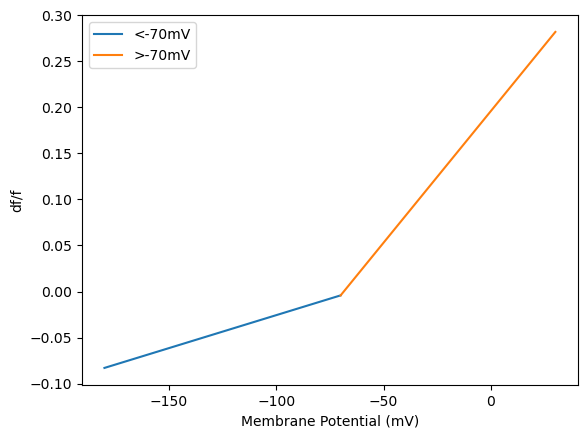

In [ ]:
# cells dict maps cell_id to Cell object
# me_type_morphology_map maps me_type to list of Morphology objects
# target populations is a list of me_types to compute signal for
target_population_cells = [
    cells[cell_id] for cell_id in cells 
        if any([t_pop in cells[cell_id].get_me_type() for 
                    t_pop in target_hVOS_populations])
]
optical_readout = {'hVOS': hVOSReadout, 'VSD': VSDReadout}[optical_type]
hvos_readout = optical_readout(target_hVOS_populations, 
                               cells, 
                               me_type_morphology_map,
                               force_overwrite=overwrite_optical_data)
target_dir = data_dir + 'archive/run' + str(run_id) + '/'
hvos_readout.compute_optical_signal(target_dir)
hvos_readout.show_voltage_to_intensity_curve()


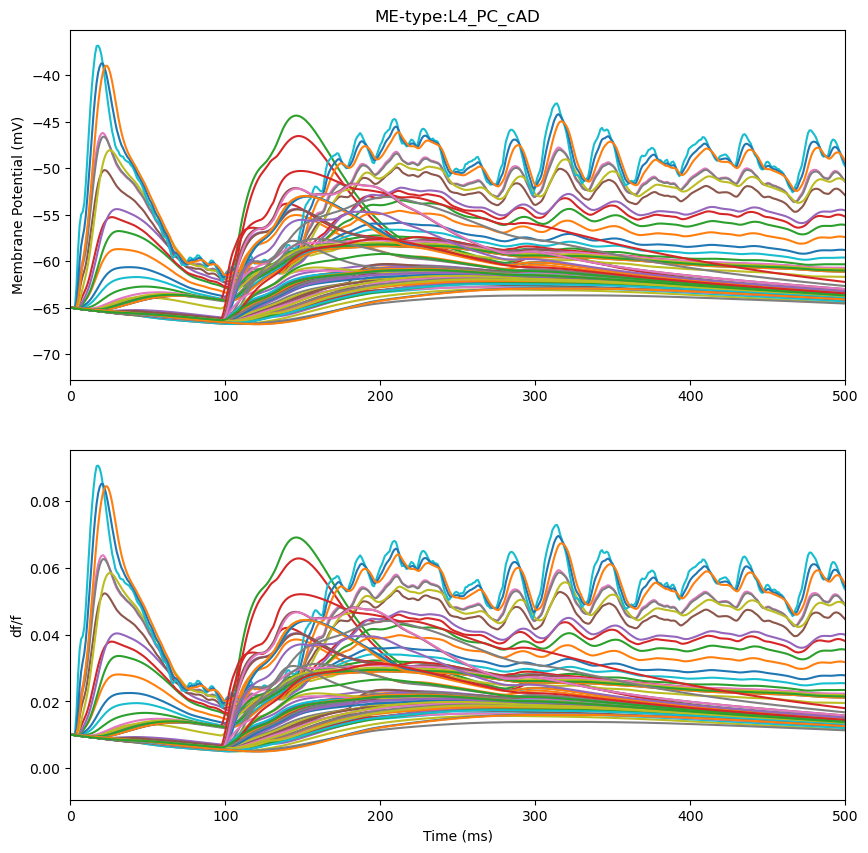

In [ ]:
# plot signal, choose random cell

cell = random.choice(target_population_cells)
compart_ids = cell.get_list_compartment_ids()
# make two subplots
fig, axs = plt.subplots(2, 1, figsize=(10, 10))
for compart_id in compart_ids:
    voltage_trace = cell.get_voltage_trace(compart_id)
    intensity_trace = cell.get_optical_trace(compart_id)
    axs[0].plot(voltage_trace, label='Voltage')
    axs[1].plot(intensity_trace, label='Intensity')
axs[1].set_xlabel('Time (ms)')
axs[0].set_ylabel('Membrane Potential (mV)')
axs[1].set_ylabel('df/f')
for ax in axs:
    ax.set_xlim(0, 500)

axs[0].set_title('ME-type:' + cell.get_me_type())

plt.show()

#
#hvos_readout.plot_optical_signal(cell_id)

In [ ]:
# determine which morphology to use for each cell
for morph_key in me_type_morphology_map:
    for morph in me_type_morphology_map[morph_key]:
        for cell in target_population_cells:
            if cell.get_me_type() == morph.me_type:

                if morph.does_cell_match_morphology(cell):
                    cell.set_morphology(morph)

print("Any target cells missing structure data?:", 
      any([cell.get_morphology() == None 
           for cell in target_population_cells]))

Any target cells missing structure data?: False


In [ ]:
psf = PSF().build_3D_PSF()

In [ ]:
# use Camera class to draw the network 
cam = Camera(target_population_cells, 
             me_type_morphology_map, 
             loaded_compart_data['time'])
cam.draw_single_frame(0)
rec = cam.get_reording()
plt.imshow(rec[0])
plt.show()

{0: {'proximal': {'x': 0.984759, 'y': -9.9799, 'z': -6.80323, 'diameter': 1.93637}, 'distal': {'x': 0.950247, 'y': -9.05028, 'z': -6.21218, 'diameter': 2.81477}}, 2: {'proximal': {'x': 0.950247, 'y': -9.05028, 'z': -6.21218, 'diameter': 2.81477}, 'distal': {'x': 0.915735, 'y': -8.12066, 'z': -5.62113, 'diameter': 4.57156}}, 3: {'proximal': {'x': 0.915735, 'y': -8.12066, 'z': -5.62113, 'diameter': 4.57156}, 'distal': {'x': 0.881223, 'y': -7.19104, 'z': -5.03008, 'diameter': 6.17758}}, 4: {'proximal': {'x': 0.881223, 'y': -7.19104, 'z': -5.03008, 'diameter': 6.17758}, 'distal': {'x': 0.846711, 'y': -6.26142, 'z': -4.43903, 'diameter': 7.6644}}, 5: {'proximal': {'x': 0.846711, 'y': -6.26142, 'z': -4.43903, 'diameter': 7.6644}, 'distal': {'x': 0.812198, 'y': -5.3318, 'z': -3.84798, 'diameter': 9.12262}}, 6: {'proximal': {'x': 0.812198, 'y': -5.3318, 'z': -3.84798, 'diameter': 9.12262}, 'distal': {'x': 0.777686, 'y': -4.40218, 'z': -3.25693, 'diameter': 11.196}}, 7: {'proximal': {'x': 0.777

IndexError: index -91 is out of bounds for axis 1 with size 80